In [1]:
!pip install tqdm

You are using pip version 10.0.1, however version 20.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [2]:
import pandas as pd
import numpy as np

from tqdm import tqdm

import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML

import datetime

from collections import Counter

import pickle

#from wordcloud import WordCloud, STOPWORDS
from nltk.stem import PorterStemmer
# spacy for lemmatization
import spacy
from spacy.lang.en import English
from spacy.lang.en.stop_words import STOP_WORDS
# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

import re

In [92]:
def tokeniser(text):
    #  "nlp" Object is used to create documents with linguistic annotations.
    my_doc = nlp(text)

    # Create list of word tokens
    token_list = gensim.utils.simple_preprocess(text, deacc=True)

    return token_list

def remove_stop_words(token_list):
    # Create list of word tokens after removing stopwords
    filtered_text =[] 

    for word in token_list:
        lexeme = nlp.vocab[word]
        if lexeme.is_stop == False:
            filtered_text.append(word) 
            
    return filtered_text 

def stemmer(token_list):
    #Prepare stemming objects
    ps = PorterStemmer()
    
    stemm_list = []
    
    for j in token_list:
        stemm_list.append(ps.stem(j))
        
    return stemm_list

def is_name(word):
    #Prepare stemming objects

    common_names = ['damian','damo','stefan','paul','dave','david','phil','rob','jack','sam','sambo','james','hamish','verity','zac','holly']
    
    common_teams = ['unit','arsen','liverpool','spurs','brighton','west ham']
    
    name_flag = 0
    
    if word in common_teams:
        name_flag = 1
    if word in common_names:
        name_flag = 2
    
    return name_flag

def remove_common_words(token_list,common_word_list):
    # Create list of word tokens after removing stopwords
    filtered_text =[] 

    for word in token_list:
        if word not in common_word_list:
            filtered_text.append(word) 
            
    return filtered_text

def CountFrequency(my_list,printing=False): 
  
    # Creating an empty dictionary  
    freq = {} 
    for item in my_list: 
        if (item in freq): 
            freq[item] += 1
        else: 
            freq[item] = 1
  
    if printing==True:       
        for key, value in freq.items(): 
                print ("{} : {}".format(key, value)) 
    return freq

#Itemise date and create a counter
def return_calander_wk(x,y,z):
    return datetime.date(x,y,z).isocalendar()[1]

def extend_weeks(x):
    if x < 10:
        x = '0{}'.format(x)
    else:
        x
    return '{}'.format(x)

def text_cleaning(x):
    return re.sub(r'[^A-Z a-z0-9]+', '', x).lower()

def pivot_cumm_word_dictionary(i,map_dict):

    df_pivot = pd.DataFrame(df_cumm['cumm_word_count_dict'][i].items(), columns=['word', 'count'])
    df_pivot['yearweek'] = df_cumm['yearweek'][i]
    df_pivot['i'] = i
    map_dict[i] = df_cumm['yearweek'][i]
    return df_pivot

#NLP Functions

def tokeniser(text):
    #  "nlp" Object is used to create documents with linguistic annotations.
    my_doc = nlp(text)

    # Create list of word tokens
    token_list = gensim.utils.simple_preprocess(text, deacc=True)

    return token_list

def draw_barchart(current_yearweek):
    
    timeline = 'i'
    
    
    colors = dict(zip(
        [0, 1, 2],
        ["#adb0ff", "#ffb3ff", "#90d595"]#, "#e48381", "#aafbff", "#f7bb5f", "#eafb50"]
    ))
    group_lk = df_pivot.set_index('word')['is_name'].to_dict()
    
    
    dff = df_pivot[df_pivot[timeline].eq(current_yearweek)].sort_values(by='count', ascending=True).tail(20)
    ax.clear()
    ax.barh(dff['word'], dff['count'], color=[colors[group_lk[x]] for x in dff['word']])
    dx = dff['count'].max()/200
    for i, (value, name) in enumerate(zip(dff['count'], dff['word'])):
        ax.text(value-dx, i-0.4,     name,           size=14, weight=600, ha='right', va='bottom')
        ax.text(value+dx, i,     f'{value:,.0f}',  size=14, ha='left',  va='center')
    ax.text(1, 0.4, map_dict[current_yearweek], transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(0, 1.06, 'count of words', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    #ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.15, 'The most popular words in the thread from 2012 to 2020',
            transform=ax.transAxes, size=24, weight=600, ha='left', va='top')
    plt.box(False)
    


In [6]:
#Load data from the full thread
df=pd.read_csv('data/PREP_combo_thread_data_20200516.csv')
df.head(3)

with open ("data/common_words.txt", 'rb') as fp:
    common_words = pickle.load(fp)

In [7]:
#Prepare yearweek counter
splits = df['date'].str.split("/", expand = True)

df['day'] = splits[0].astype(int)
df['month'] = splits[1].astype(int)
df['year'] = splits[2].astype(int)

df['week'] = df.apply(lambda x:return_calander_wk(x.year, x.month, x.day), axis=1)

df['week'] = df['week'].apply(lambda x:extend_weeks(x))

df['yearweek'] = df['year'].astype(str)+df['week'].astype(str)
df['yearweek'] = df['yearweek'].astype(int)
df['text'] = df['text'].astype(str)

In [47]:
#Aggregate words per yearweek
df_agg = df.groupby(['yearweek'])['text'].apply(''.join).reset_index()

#Prepare stemming objects
ps = PorterStemmer()

# Load English tokenizer, tagger, parser, NER and word vectors
nlp = English()

df_agg['words'] = df_agg['text'].apply(lambda x: text_cleaning(x))
df_agg['words'] = df_agg['words'].apply(lambda x: tokeniser(x))
df_agg['words'] = df_agg['words'].apply(lambda x: remove_stop_words(x))
df_agg['words'] = df_agg['words'].apply(lambda x: remove_common_words(x,common_words))
df_agg['words'] = df_agg['words'].apply(lambda x: stemmer(x))

df_agg['word_count_dict'] = df_agg['words'].apply(lambda x: CountFrequency(x))

In [41]:
# Loop through the thread in chronological order and count each new instance of a word. Save as a dictionary. 
df_agg = df_agg.sort_values(by='yearweek', ascending=True)

df_agg['cumm_word_count_dict'] = df_agg['word_count_dict']

for i in tqdm(np.arange(len(df_agg))):
    if i != 0:
        current_words = df_agg['word_count_dict'][i]
        previous_cumm_words = df_agg['cumm_word_count_dict'][i-1]
        df_agg['cumm_word_count_dict'][i] = dict(Counter(current_words)+Counter(previous_cumm_words))
        
df_cumm = df_agg[['yearweek','cumm_word_count_dict']]      

  0%|          | 0/412 [00:00<?, ?it/s]/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
100%|██████████| 412/412 [00:50<00:00,  8.12it/s]


In [88]:
map_dict = {}

df_pivot = pivot_cumm_word_dictionary(0,map_dict)

for i in tqdm(np.arange(len(df_cumm))):
    df_pivot_i = pivot_cumm_word_dictionary(i,map_dict)
    df_pivot = pd.concat([df_pivot,df_pivot_i])
    


100%|██████████| 412/412 [00:20<00:00, 20.10it/s] 


In [93]:
df_pivot['is_name'] = df_pivot['word'].apply(lambda x: is_name(x))

In [94]:
df_pivot['is_name'].unique()

array([0, 1, 2])

In [95]:
#Check data frame for a given year
#current_yearweek = 202013
current_yearweek = 400

dff = df_pivot[df_pivot['i'].eq(current_yearweek)].sort_values(by='is_name', ascending=False).head(10)
dff#.head()

,word,count,yearweek,i,is_name
320,jack,13,202002,400,2
2362,sambo,67,202002,400,2
5721,damo,20,202002,400,2
16654,stefan,3,202002,400,2
16272,david,2,202002,400,2
6946,rob,35,202002,400,2
437,dave,44,202002,400,2
3239,damian,22,202002,400,2
6522,hamish,5,202002,400,2
1764,phil,35,202002,400,2


array([1, 2])

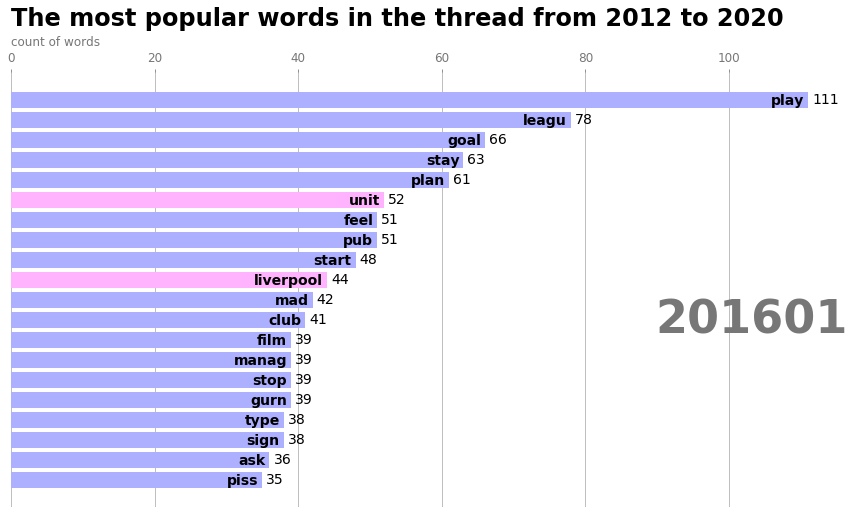

In [122]:
fig, ax = plt.subplots(figsize=(15, 8))

draw_barchart(190)

Animation size has reached 20974629 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


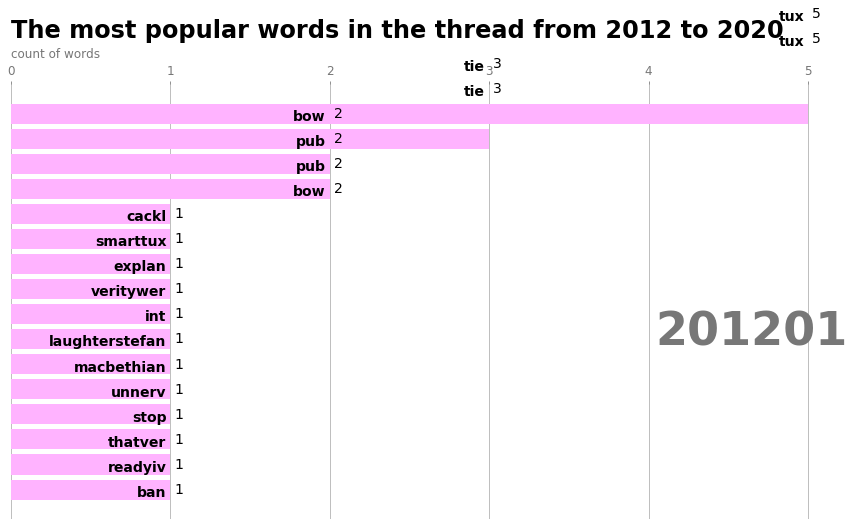

In [75]:
fig, ax = plt.subplots(figsize=(15, 8))

animator = animation.FuncAnimation(fig, draw_barchart, frames=range(0, 411), blit=False, interval=200, repeat=True,  save_count=1000)

HTML(animator.to_jshtml())

MovieWriter ffmpeg unavailable. Trying to use pillow instead.


ValueError: unknown file extension: .mp4

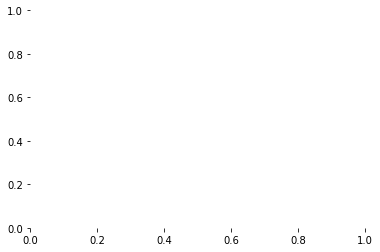

In [97]:
#Save animation as a gif
animator.save('the_thread_growth_in_words.mp4')

In [ ]:
'''
colors = dict(zip(
    ["India", "Europe", "Asia", "Latin America", "Middle East", "North America", "Africa"],
    ["#adb0ff", "#ffb3ff", "#90d595", "#e48381", "#aafbff", "#f7bb5f", "#eafb50"]
))
group_lk = df.set_index('name')['group'].to_dict()
'''